# Validate the parachute deployment algorithm

In [1]:
import numpy as np, random, operator, pandas as pd, matplotlib.pyplot as plt

### Add spaceX-CRS-8 (time, velocity, altitude) data
### 이상적인 데이터 df1

In [2]:
df1 = pd.read_csv("Datas/SpaceX_CRS-8.csv")
df1.shape

(21823, 3)

In [3]:
df1

,time,velocity,altitude
0,0.000,0.000,0.0
1,0.033,0.277,0.0
2,0.066,0.277,0.0
3,0.100,0.277,0.0
4,0.133,0.555,0.0
...,...,...,...
21818,734.533,7526.111,218.0
21819,734.566,7526.111,218.0
21820,734.599,7526.111,218.0
21821,734.633,7526.111,218.0


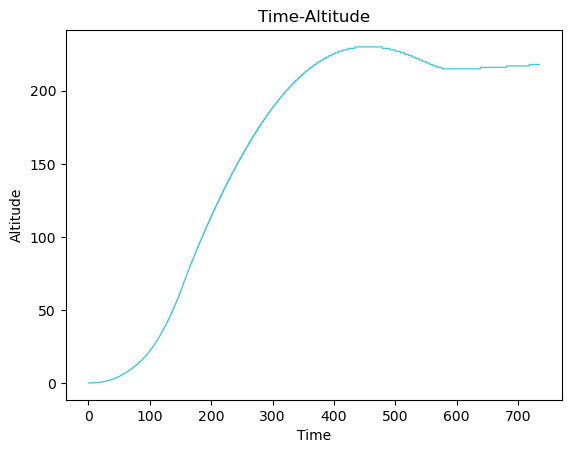

In [4]:
plt.plot(df1['time'], df1['altitude'], color='#3bc9db', lw=0.9)
plt.title('Time-Altitude')
plt.xlabel('Time')
plt.ylabel('Altitude')

plt.show()

### Add spaceX-CRS-12 (time, velocity, altitude) data
### 상승 후 감소 데이터 df2

In [5]:
df2 = pd.read_csv("Datas/SpaceX_CRS-12.csv")
df2.shape

(13684, 3)

In [6]:
df2

,time,velocity,altitude
0,0.000,0.000,0.0
1,0.033,0.277,0.0
2,0.066,0.555,0.0
3,0.100,0.555,0.0
4,0.133,0.555,0.0
...,...,...,...
13679,479.946,0.000,0.0
13680,479.979,0.000,0.0
13681,480.012,0.000,0.0
13682,480.046,0.000,0.0


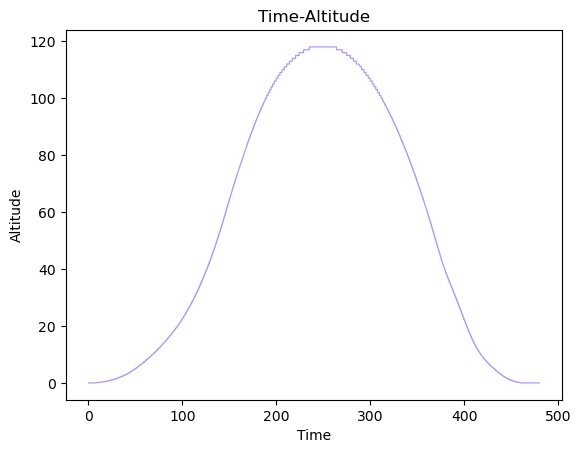

In [7]:
plt.plot(df2['time'], df2['altitude'], color='#b197fc', lw=0.9)
plt.title('Time-Altitude')
plt.xlabel('Time')
plt.ylabel('Altitude')

plt.show()

### Add Custom data
### 이상치 포함 데이터 df3

In [8]:
df3 = pd.read_csv("Datas/Custom.csv")
df3.shape

(15195, 3)

In [9]:
df3

,time,velocity,altitude
0,0.000,0.000,0.0
1,0.033,0.277,0.0
2,0.066,0.555,0.0
3,0.100,0.555,0.0
4,0.133,0.555,0.0
...,...,...,...
15190,558.791,7537.500,207.0
15191,558.824,7537.500,207.0
15192,558.858,7537.500,207.0
15193,558.891,7537.500,207.0


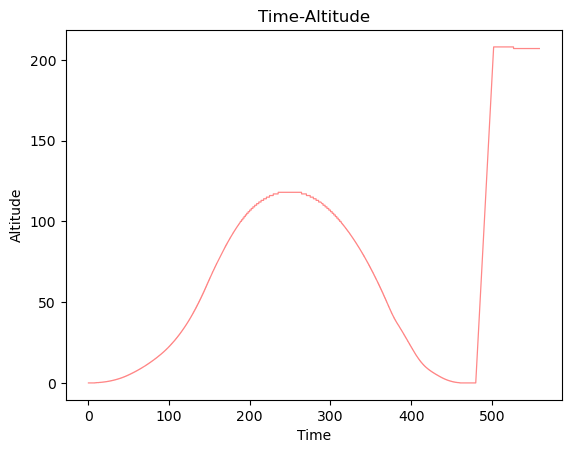

In [10]:
plt.plot(df3['time'], df3['altitude'], color='#ff8787', lw=0.9)
plt.title('Time-Altitude')
plt.xlabel('Time')
plt.ylabel('Altitude')

plt.show()

## parachute deployment algorithm

## Analyze of THRESHOLD

### df1, THRESHOLD = 2

In [13]:
datas = df1['altitude']

#Check all dataframe's Nan.
nan_check = datas.isna().any().any()

if nan_check:
    print("NaN 값이 존재합니다.")
else:
    print("NaN 값이 없습니다.")
print("------------------------------------------")

#Add radom decimal point
for i in range(0, len(datas)):
    if(datas[i] != 0):
        datas[i] = datas[i] + random.uniform(0.0001, 0.01)

datas

NaN 값이 없습니다.
------------------------------------------


0          0.000000
1          0.000000
2          0.000000
3          0.000000
4          0.000000
            ...    
21818    218.005422
21819    218.009378
21820    218.008714
21821    218.006523
21822    218.004436
Name: altitude, Length: 21823, dtype: float64

In [24]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 255
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10938
Detected outlier with : 1.00
------------------------------------------------------------------
index: 256
Mean : 0.02
Std : 0.04
Z-score : 1.98
Altitude : 0.10755
Detected outlier with : 1.00
------------------------------------------------------------------
index: 257
Mean : 0.03
Std : 0.05
Z-score : 1.48
Altitude : 0.10506
Detected outlier with : 1.00
------------------------------------------------------------------
index: 258
Mean : 0.04
Std : 0.05
Z-score : 1.13
Altitude : 0.10116
Detected outlier with : 1.00
------------------------------------------------------------------
index: 259
Mean : 0.05
Std : 0.05
Z-score : 0.98
Altitude : 0.10452
Detected outlier with : 1.00
------------------------------------------------------------------
index: 260
Mean : 0.06
Std : 0.05
Z-score : 0.84
Altitude : 0.10713
Detected outlier with : 1.00
------------------------------------------------------------------
index: 261
Mean 

index: 1110
Mean : 2.20
Std : 0.00
Z-score : 0.85
Altitude : 2.20679
Detected outlier with : 41.00
------------------------------------------------------------------
index: 1111
Mean : 2.20
Std : 0.00
Z-score : 1.22
Altitude : 2.20874
Detected outlier with : 41.00
------------------------------------------------------------------
index: 1112
Mean : 2.21
Std : 0.00
Z-score : 0.55
Altitude : 2.20706
Detected outlier with : 41.00
------------------------------------------------------------------
index: 1113
Mean : 2.21
Std : 0.00
Z-score : 1.21
Altitude : 2.20995
Detected outlier with : 41.00
------------------------------------------------------------------
index: 1114
Mean : 2.21
Std : 0.00
Z-score : 0.54
Altitude : 2.20828
Detected outlier with : 41.00
------------------------------------------------------------------
index: 1115
Mean : 2.21
Std : 0.00
Z-score : -0.76
Altitude : 2.20523
Detected outlier with : 41.00
------------------------------------------------------------------
ind

index: 3642
Mean : 36.10
Std : 0.08
Z-score : 1.28
Altitude : 36.20427
Detected outlier with : 363.00
------------------------------------------------------------------
index: 3643
Mean : 36.12
Std : 0.08
Z-score : 1.09
Altitude : 36.20716
Detected outlier with : 363.00
------------------------------------------------------------------
index: 3644
Mean : 36.15
Std : 0.08
Z-score : 1.80
Altitude : 36.30015
Detected outlier with : 363.00
------------------------------------------------------------------
index: 3645
Mean : 36.18
Std : 0.07
Z-score : 1.61
Altitude : 36.30492
Detected outlier with : 363.00
------------------------------------------------------------------
index: 3646
Mean : 36.21
Std : 0.08
Z-score : 1.34
Altitude : 36.30915
Detected outlier with : 363.00
------------------------------------------------------------------
index: 3647
Mean : 36.23
Std : 0.07
Z-score : 1.04
Altitude : 36.30258
Detected outlier with : 363.00
-----------------------------------------------------

index: 5521
Mean : 100.31
Std : 0.46
Z-score : 1.53
Altitude : 101.00684
Detected outlier with : 398.00
------------------------------------------------------------------
index: 5522
Mean : 100.41
Std : 0.49
Z-score : 1.23
Altitude : 101.00629
Detected outlier with : 398.00
------------------------------------------------------------------
index: 5523
Mean : 100.51
Std : 0.50
Z-score : 1.00
Altitude : 101.00419
Detected outlier with : 398.00
------------------------------------------------------------------
index: 5524
Mean : 100.61
Std : 0.49
Z-score : 0.82
Altitude : 101.00821
Detected outlier with : 398.00
------------------------------------------------------------------
index: 5525
Mean : 100.71
Std : 0.46
Z-score : 0.66
Altitude : 101.00527
Detected outlier with : 398.00
------------------------------------------------------------------
index: 5526
Mean : 100.80
Std : 0.40
Z-score : 0.50
Altitude : 101.00421
Detected outlier with : 398.00
-----------------------------------------

index: 6978
Mean : 144.01
Std : 0.00
Z-score : -1.22
Altitude : 144.00083
Detected outlier with : 470.00
------------------------------------------------------------------
index: 6979
Mean : 144.00
Std : 0.00
Z-score : 0.78
Altitude : 144.00760
Detected outlier with : 470.00
------------------------------------------------------------------
index: 6980
Mean : 144.01
Std : 0.00
Z-score : -0.69
Altitude : 144.00304
Detected outlier with : 470.00
------------------------------------------------------------------
index: 6981
Mean : 144.01
Std : 0.00
Z-score : -0.22
Altitude : 144.00488
Detected outlier with : 470.00
------------------------------------------------------------------
index: 6982
Mean : 144.01
Std : 0.00
Z-score : 0.08
Altitude : 144.00547
Detected outlier with : 470.00
------------------------------------------------------------------
index: 6983
Mean : 144.01
Std : 0.00
Z-score : -0.40
Altitude : 144.00443
Detected outlier with : 470.00
-------------------------------------

index: 9085
Mean : 191.01
Std : 0.00
Z-score : 1.11
Altitude : 191.00853
Detected outlier with : 559.00
------------------------------------------------------------------
index: 9086
Mean : 191.01
Std : 0.00
Z-score : -1.27
Altitude : 191.00096
Detected outlier with : 559.00
------------------------------------------------------------------
index: 9087
Mean : 191.01
Std : 0.00
Z-score : 1.21
Altitude : 191.00979
Detected outlier with : 559.00
------------------------------------------------------------------
index: 9088
Mean : 191.01
Std : 0.00
Z-score : 0.98
Altitude : 191.00963
Detected outlier with : 559.00
------------------------------------------------------------------
index: 9089
Mean : 191.01
Std : 0.00
Z-score : -0.64
Altitude : 191.00480
Detected outlier with : 559.00
------------------------------------------------------------------
index: 9090
Mean : 191.01
Std : 0.00
Z-score : -1.49
Altitude : 191.00096
Detected outlier with : 559.00
--------------------------------------

index: 12476
Mean : 228.01
Std : 0.00
Z-score : -1.85
Altitude : 228.00033
Detected outlier with : 660.00
------------------------------------------------------------------
index: 12477
Mean : 228.00
Std : 0.00
Z-score : -1.39
Altitude : 228.00056
Detected outlier with : 660.00
------------------------------------------------------------------
index: 12478
Mean : 228.01
Std : 0.00
Z-score : 1.28
Altitude : 228.00958
Detected outlier with : 660.00
------------------------------------------------------------------
index: 12479
Mean : 228.01
Std : 0.00
Z-score : 0.65
Altitude : 228.00740
Detected outlier with : 660.00
------------------------------------------------------------------
index: 12480
Mean : 228.01
Std : 0.00
Z-score : -0.47
Altitude : 228.00395
Detected outlier with : 660.00
------------------------------------------------------------------
index: 12481
Mean : 228.01
Std : 0.00
Z-score : -0.78
Altitude : 228.00252
Detected outlier with : 660.00
-------------------------------

index: 17167
Mean : 215.01
Std : 0.00
Z-score : 0.24
Altitude : 215.00569
Detected outlier with : 753.00
------------------------------------------------------------------
index: 17168
Mean : 215.00
Std : 0.00
Z-score : 1.33
Altitude : 215.00773
Detected outlier with : 753.00
------------------------------------------------------------------
index: 17169
Mean : 215.01
Std : 0.00
Z-score : 1.61
Altitude : 215.00939
Detected outlier with : 753.00
------------------------------------------------------------------
index: 17170
Mean : 215.00
Std : 0.00
Z-score : -1.54
Altitude : 215.00105
Detected outlier with : 753.00
------------------------------------------------------------------
index: 17171
Mean : 215.01
Std : 0.00
Z-score : 1.10
Altitude : 215.00802
Detected outlier with : 753.00
------------------------------------------------------------------
index: 17172
Mean : 215.01
Std : 0.00
Z-score : -0.89
Altitude : 215.00315
Detected outlier with : 753.00
---------------------------------

index: 21217
Mean : 217.00
Std : 0.00
Z-score : -0.08
Altitude : 217.00422
Detected outlier with : 806.00
------------------------------------------------------------------
index: 21218
Mean : 217.00
Std : 0.00
Z-score : 1.11
Altitude : 217.00803
Detected outlier with : 806.00
------------------------------------------------------------------
index: 21219
Mean : 217.01
Std : 0.00
Z-score : 1.14
Altitude : 217.00860
Detected outlier with : 806.00
------------------------------------------------------------------
index: 21220
Mean : 217.00
Std : 0.00
Z-score : -1.18
Altitude : 217.00071
Detected outlier with : 806.00
------------------------------------------------------------------
index: 21221
Mean : 217.00
Std : 0.00
Z-score : 1.38
Altitude : 217.00910
Detected outlier with : 806.00
------------------------------------------------------------------
index: 21222
Mean : 217.00
Std : 0.00
Z-score : -0.32
Altitude : 217.00406
Detected outlier with : 806.00
--------------------------------

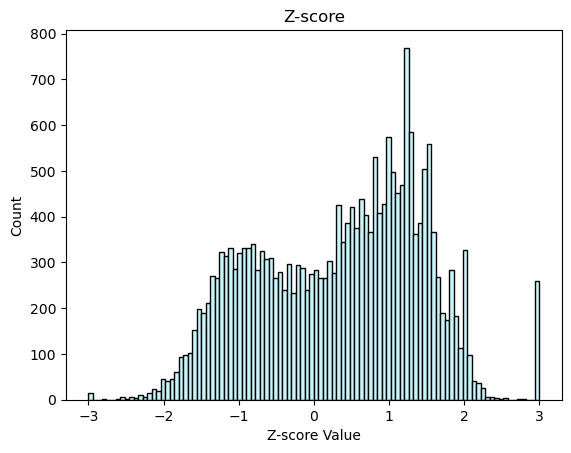

Outliner's count : 816.00


In [27]:
plt.hist(zList, bins=100, color='#c5f6fa', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

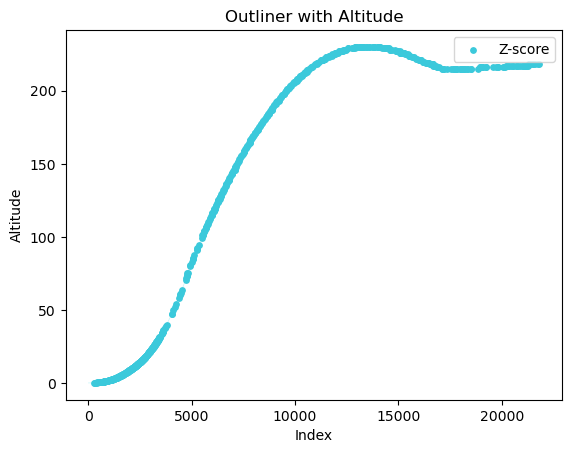

In [28]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df1.index, df1['altitude'], color='#c5f6fa',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#3bc9db', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df1, THRESHOLD=2.9

In [29]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2.9  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 255
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10938
Detected outlier with : 1.00
------------------------------------------------------------------
index: 256
Mean : 0.02
Std : 0.04
Z-score : 1.98
Altitude : 0.10755
Detected outlier with : 1.00
------------------------------------------------------------------
index: 257
Mean : 0.03
Std : 0.05
Z-score : 1.48
Altitude : 0.10506
Detected outlier with : 1.00
------------------------------------------------------------------
index: 258
Mean : 0.04
Std : 0.05
Z-score : 1.13
Altitude : 0.10116
Detected outlier with : 1.00
------------------------------------------------------------------
index: 259
Mean : 0.05
Std : 0.05
Z-score : 0.98
Altitude : 0.10452
Detected outlier with : 1.00
------------------------------------------------------------------
index: 260
Mean : 0.06
Std : 0.05
Z-score : 0.84
Altitude : 0.10713
Detected outlier with : 1.00
------------------------------------------------------------------
index: 261
Mean 

index: 1061
Mean : 2.00
Std : 0.03
Z-score : 0.31
Altitude : 2.00502
Detected outlier with : 20.00
------------------------------------------------------------------
index: 1062
Mean : 2.01
Std : 0.00
Z-score : -0.72
Altitude : 2.00377
Detected outlier with : 20.00
------------------------------------------------------------------
index: 1063
Mean : 2.01
Std : 0.00
Z-score : 1.12
Altitude : 2.00874
Detected outlier with : 20.00
------------------------------------------------------------------
index: 1064
Mean : 2.01
Std : 0.00
Z-score : -0.11
Altitude : 2.00564
Detected outlier with : 20.00
------------------------------------------------------------------
index: 1065
Mean : 2.01
Std : 0.00
Z-score : 0.21
Altitude : 2.00644
Detected outlier with : 20.00
------------------------------------------------------------------
index: 1066
Mean : 2.01
Std : 0.00
Z-score : -1.64
Altitude : 2.00164
Detected outlier with : 20.00
------------------------------------------------------------------
i

index: 3143
Mean : 24.67
Std : 0.07
Z-score : 2.06
Altitude : 24.80983
Detected outlier with : 127.00
------------------------------------------------------------------
index: 3144
Mean : 24.70
Std : 0.07
Z-score : 1.57
Altitude : 24.80719
Detected outlier with : 127.00
------------------------------------------------------------------
index: 3145
Mean : 24.72
Std : 0.07
Z-score : 1.24
Altitude : 24.80234
Detected outlier with : 127.00
------------------------------------------------------------------
index: 3146
Mean : 24.74
Std : 0.06
Z-score : 1.10
Altitude : 24.80609
Detected outlier with : 127.00
------------------------------------------------------------------
index: 3147
Mean : 24.76
Std : 0.05
Z-score : 0.93
Altitude : 24.80174
Detected outlier with : 127.00
------------------------------------------------------------------
index: 3148
Mean : 24.76
Std : 0.05
Z-score : 0.77
Altitude : 24.80275
Detected outlier with : 127.00
-----------------------------------------------------

index: 8010
Mean : 169.01
Std : 0.00
Z-score : -1.77
Altitude : 169.00174
Detected outlier with : 196.00
------------------------------------------------------------------
index: 8011
Mean : 169.01
Std : 0.00
Z-score : 1.57
Altitude : 169.00979
Detected outlier with : 196.00
------------------------------------------------------------------
index: 8012
Mean : 169.01
Std : 0.00
Z-score : -0.40
Altitude : 169.00458
Detected outlier with : 196.00
------------------------------------------------------------------
index: 8013
Mean : 169.01
Std : 0.00
Z-score : -0.77
Altitude : 169.00328
Detected outlier with : 196.00
------------------------------------------------------------------
index: 8014
Mean : 169.01
Std : 0.00
Z-score : -1.06
Altitude : 169.00232
Detected outlier with : 196.00
------------------------------------------------------------------
index: 8015
Mean : 169.00
Std : 0.00
Z-score : -1.11
Altitude : 169.00155
Detected outlier with : 196.00
------------------------------------

index: 12845
Mean : 229.01
Std : 0.00
Z-score : 0.79
Altitude : 229.00746
Detected outlier with : 256.00
------------------------------------------------------------------
index: 12846
Mean : 229.01
Std : 0.00
Z-score : -1.07
Altitude : 229.00353
Detected outlier with : 256.00
------------------------------------------------------------------
index: 12847
Mean : 229.01
Std : 0.00
Z-score : 0.79
Altitude : 229.00768
Detected outlier with : 256.00
------------------------------------------------------------------
index: 12848
Mean : 229.01
Std : 0.00
Z-score : -1.36
Altitude : 229.00232
Detected outlier with : 256.00
------------------------------------------------------------------
index: 12849
Mean : 229.01
Std : 0.00
Z-score : -0.73
Altitude : 229.00341
Detected outlier with : 256.00
------------------------------------------------------------------
index: 12850
Mean : 229.00
Std : 0.00
Z-score : -0.98
Altitude : 229.00231
Detected outlier with : 256.00
-------------------------------

index: 14056
Mean : 230.01
Std : 0.00
Z-score : 1.66
Altitude : 230.00978
Detected outlier with : 257.00
------------------------------------------------------------------
index: 14057
Mean : 230.01
Std : 0.00
Z-score : 0.94
Altitude : 230.00832
Detected outlier with : 257.00
------------------------------------------------------------------
index: 14058
Mean : 230.01
Std : 0.00
Z-score : 1.27
Altitude : 230.00999
Detected outlier with : 257.00
------------------------------------------------------------------
index: 14059
Mean : 230.01
Std : 0.00
Z-score : -1.05
Altitude : 230.00313
Detected outlier with : 257.00
------------------------------------------------------------------
index: 14060
Mean : 230.01
Std : 0.00
Z-score : -0.39
Altitude : 230.00503
Detected outlier with : 257.00
------------------------------------------------------------------
index: 14061
Mean : 230.01
Std : 0.00
Z-score : 0.01
Altitude : 230.00580
Detected outlier with : 257.00
---------------------------------

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



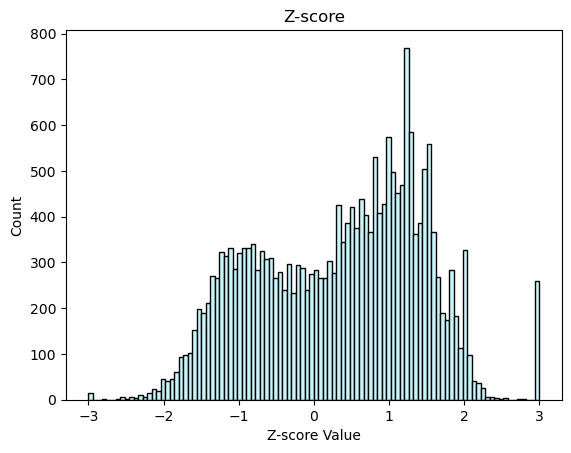

Outliner's count : 275.00


In [30]:
plt.hist(zList, bins=100, color='#c5f6fa', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

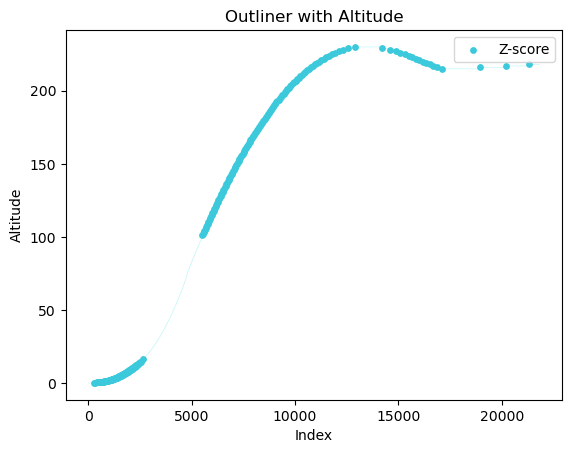

In [31]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df1.index, df1['altitude'], color='#c5f6fa',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#3bc9db', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df1, THRESHOLD=3

In [32]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 3  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 255
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10938
Detected outlier with : 0.00
------------------------------------------------------------------
index: 256
Mean : 0.02
Std : 0.04
Z-score : 1.98
Altitude : 0.10755
Detected outlier with : 0.00
------------------------------------------------------------------
index: 257
Mean : 0.03
Std : 0.05
Z-score : 1.48
Altitude : 0.10506
Detected outlier with : 0.00
------------------------------------------------------------------
index: 258
Mean : 0.04
Std : 0.05
Z-score : 1.13
Altitude : 0.10116
Detected outlier with : 0.00
------------------------------------------------------------------
index: 259
Mean : 0.05
Std : 0.05
Z-score : 0.98
Altitude : 0.10452
Detected outlier with : 0.00
------------------------------------------------------------------
index: 260
Mean : 0.06
Std : 0.05
Z-score : 0.84
Altitude : 0.10713
Detected outlier with : 0.00
------------------------------------------------------------------
index: 261
Mean 

index: 2669
Mean : 16.55
Std : 0.05
Z-score : 1.29
Altitude : 16.60944
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2670
Mean : 16.56
Std : 0.05
Z-score : 0.91
Altitude : 16.60045
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2671
Mean : 16.57
Std : 0.05
Z-score : 0.88
Altitude : 16.60899
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2672
Mean : 16.59
Std : 0.06
Z-score : 2.00
Altitude : 16.70584
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2673
Mean : 16.61
Std : 0.06
Z-score : 1.62
Altitude : 16.70947
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2674
Mean : 16.63
Std : 0.06
Z-score : 1.32
Altitude : 16.70740
Detected outlier with : 0.00
-----------------------------------------------------------------

index: 6022
Mean : 116.01
Std : 0.00
Z-score : -0.50
Altitude : 116.00352
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6023
Mean : 116.01
Std : 0.00
Z-score : -0.20
Altitude : 116.00452
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6024
Mean : 116.11
Std : 0.30
Z-score : 3.00
Altitude : 117.00887
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6025
Mean : 116.21
Std : 0.40
Z-score : 1.99
Altitude : 117.00468
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6026
Mean : 116.31
Std : 0.46
Z-score : 1.53
Altitude : 117.00927
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6027
Mean : 116.41
Std : 0.49
Z-score : 1.22
Altitude : 117.00708
Detected outlier with : 0.00
---------------------------------------------------

index: 8239
Mean : 174.10
Std : 0.30
Z-score : 3.00
Altitude : 175.00091
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8240
Mean : 174.20
Std : 0.40
Z-score : 2.00
Altitude : 175.00102
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8241
Mean : 174.30
Std : 0.46
Z-score : 1.53
Altitude : 175.00530
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8242
Mean : 174.40
Std : 0.49
Z-score : 1.22
Altitude : 175.00107
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8243
Mean : 174.50
Std : 0.50
Z-score : 1.01
Altitude : 175.00902
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8244
Mean : 174.60
Std : 0.49
Z-score : 0.82
Altitude : 175.00558
Detected outlier with : 0.00
-----------------------------------------------------

index: 9817
Mean : 203.00
Std : 0.00
Z-score : -0.16
Altitude : 203.00424
Detected outlier with : 0.00
------------------------------------------------------------------
index: 9818
Mean : 203.01
Std : 0.00
Z-score : 0.47
Altitude : 203.00575
Detected outlier with : 0.00
------------------------------------------------------------------
index: 9819
Mean : 203.01
Std : 0.00
Z-score : 0.41
Altitude : 203.00588
Detected outlier with : 0.00
------------------------------------------------------------------
index: 9820
Mean : 203.01
Std : 0.00
Z-score : -0.00
Altitude : 203.00519
Detected outlier with : 0.00
------------------------------------------------------------------
index: 9821
Mean : 203.01
Std : 0.00
Z-score : 1.91
Altitude : 203.00783
Detected outlier with : 0.00
------------------------------------------------------------------
index: 9822
Mean : 203.01
Std : 0.00
Z-score : 1.70
Altitude : 203.00836
Detected outlier with : 0.00
---------------------------------------------------

index: 12444
Mean : 228.01
Std : 0.00
Z-score : -0.39
Altitude : 228.00633
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12445
Mean : 228.01
Std : 0.00
Z-score : -2.31
Altitude : 228.00035
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12446
Mean : 228.01
Std : 0.00
Z-score : -0.32
Altitude : 228.00511
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12447
Mean : 228.01
Std : 0.00
Z-score : 0.58
Altitude : 228.00733
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12448
Mean : 228.01
Std : 0.00
Z-score : -1.55
Altitude : 228.00160
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12449
Mean : 228.01
Std : 0.00
Z-score : 1.21
Altitude : 228.00861
Detected outlier with : 0.00
-------------------------------------------

index: 15808
Mean : 223.01
Std : 0.00
Z-score : 1.26
Altitude : 223.00936
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15809
Mean : 223.01
Std : 0.00
Z-score : 0.80
Altitude : 223.00863
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15810
Mean : 223.01
Std : 0.00
Z-score : -1.60
Altitude : 223.00205
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15811
Mean : 223.01
Std : 0.00
Z-score : 0.94
Altitude : 223.00938
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15812
Mean : 223.01
Std : 0.00
Z-score : 0.40
Altitude : 223.00797
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15813
Mean : 223.01
Std : 0.00
Z-score : -1.00
Altitude : 223.00323
Detected outlier with : 0.00
---------------------------------------------

index: 20400
Mean : 217.01
Std : 0.00
Z-score : -1.46
Altitude : 217.00142
Detected outlier with : 0.00
------------------------------------------------------------------
index: 20401
Mean : 217.01
Std : 0.00
Z-score : 0.05
Altitude : 217.00548
Detected outlier with : 0.00
------------------------------------------------------------------
index: 20402
Mean : 217.00
Std : 0.00
Z-score : -0.39
Altitude : 217.00388
Detected outlier with : 0.00
------------------------------------------------------------------
index: 20403
Mean : 217.01
Std : 0.00
Z-score : 1.48
Altitude : 217.00952
Detected outlier with : 0.00
------------------------------------------------------------------
index: 20404
Mean : 217.01
Std : 0.00
Z-score : -0.08
Altitude : 217.00515
Detected outlier with : 0.00
------------------------------------------------------------------
index: 20405
Mean : 217.01
Std : 0.00
Z-score : 0.78
Altitude : 217.00795
Detected outlier with : 0.00
--------------------------------------------

index: 21582
Mean : 218.00
Std : 0.00
Z-score : 0.52
Altitude : 218.00606
Detected outlier with : 0.00
------------------------------------------------------------------
index: 21583
Mean : 218.00
Std : 0.00
Z-score : -0.89
Altitude : 218.00302
Detected outlier with : 0.00
------------------------------------------------------------------
index: 21584
Mean : 218.01
Std : 0.00
Z-score : -0.11
Altitude : 218.00507
Detected outlier with : 0.00
------------------------------------------------------------------
index: 21585
Mean : 218.00
Std : 0.00
Z-score : -1.72
Altitude : 218.00103
Detected outlier with : 0.00
------------------------------------------------------------------
index: 21586
Mean : 218.01
Std : 0.00
Z-score : 1.55
Altitude : 218.00865
Detected outlier with : 0.00
------------------------------------------------------------------
index: 21587
Mean : 218.00
Std : 0.00
Z-score : -1.55
Altitude : 218.00119
Detected outlier with : 0.00
-------------------------------------------

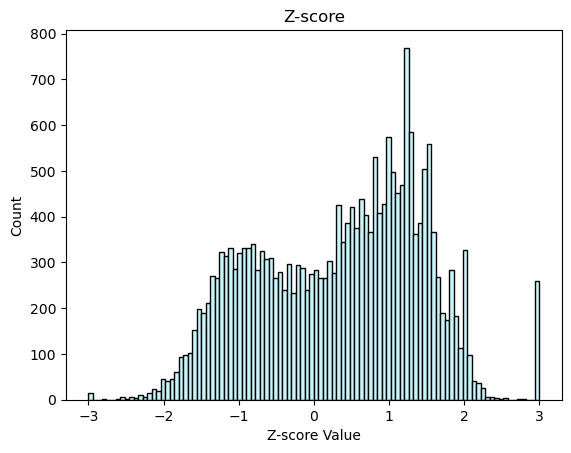

Outliner's count : 0.00


In [33]:
plt.hist(zList, bins=100, color='#c5f6fa', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

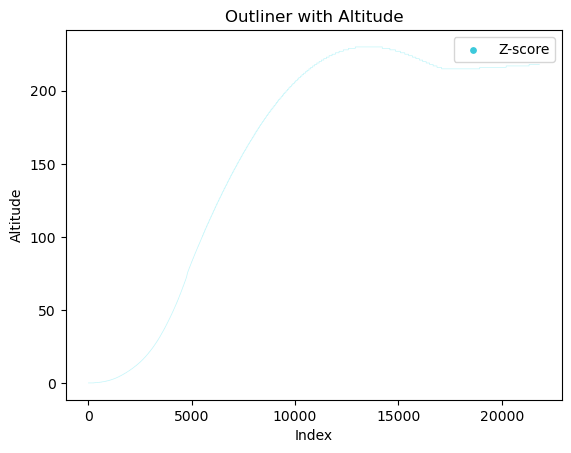

In [34]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df1.index, df1['altitude'], color='#c5f6fa',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#3bc9db', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df2, THRESHOLD=2.9

In [35]:
datas = df2['altitude']

#Check all dataframe's Nan.
nan_check = datas.isna().any().any()

if nan_check:
    print("NaN 값이 존재합니다.")
else:
    print("NaN 값이 없습니다.")
print("------------------------------------------")

#Add radom decimal point
for i in range(0, len(datas)):
    if(datas[i] != 0):
        datas[i] = datas[i] + random.uniform(0.0001, 0.01)

datas

NaN 값이 없습니다.
------------------------------------------


0        0.0
1        0.0
2        0.0
3        0.0
4        0.0
        ... 
13679    0.0
13680    0.0
13681    0.0
13682    0.0
13683    0.0
Name: altitude, Length: 13684, dtype: float64

In [36]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2.9  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10234
Detected outlier with : 1.00
------------------------------------------------------------------
index: 233
Mean : 0.02
Std : 0.04
Z-score : 2.05
Altitude : 0.10673
Detected outlier with : 1.00
------------------------------------------------------------------
index: 234
Mean : 0.03
Std : 0.05
Z-score : 1.47
Altitude : 0.10078
Detected outlier with : 1.00
------------------------------------------------------------------
index: 235
Mean : 0.04
Std : 0.05
Z-score : 1.20
Altitude : 0.10143
Detected outlier with : 1.00
------------------------------------------------------------------
index: 236
Mean : 0.05
Std : 0.05
Z-score : 1.11
Altitude : 0.10974
Detected outlier with : 1.00
------------------------------------------------------------------
index: 237
Mean : 0.06
Std : 0.05
Z-score : 0.76
Altitude : 0.10088
Detected outlier with : 1.00
------------------------------------------------------------------
index: 238
Mean 

index: 1485
Mean : 5.15
Std : 0.05
Z-score : 1.01
Altitude : 5.20351
Detected outlier with : 52.00
------------------------------------------------------------------
index: 1486
Mean : 5.16
Std : 0.05
Z-score : 0.86
Altitude : 5.20575
Detected outlier with : 52.00
------------------------------------------------------------------
index: 1487
Mean : 5.17
Std : 0.05
Z-score : 0.65
Altitude : 5.20311
Detected outlier with : 52.00
------------------------------------------------------------------
index: 1488
Mean : 5.18
Std : 0.04
Z-score : 0.62
Altitude : 5.20872
Detected outlier with : 52.00
------------------------------------------------------------------
index: 1489
Mean : 5.19
Std : 0.03
Z-score : 0.46
Altitude : 5.20841
Detected outlier with : 52.00
------------------------------------------------------------------
index: 1490
Mean : 5.20
Std : 0.00
Z-score : 1.12
Altitude : 5.20806
Detected outlier with : 52.00
------------------------------------------------------------------
inde

index: 5487
Mean : 101.01
Std : 0.00
Z-score : -0.58
Altitude : 101.00458
Detected outlier with : 122.00
------------------------------------------------------------------
index: 5488
Mean : 101.11
Std : 0.30
Z-score : 3.00
Altitude : 102.00477
Detected outlier with : 123.00
------------------------------------------------------------------
index: 5489
Mean : 101.21
Std : 0.40
Z-score : 2.00
Altitude : 102.00603
Detected outlier with : 123.00
------------------------------------------------------------------
index: 5490
Mean : 101.31
Std : 0.46
Z-score : 1.53
Altitude : 102.00653
Detected outlier with : 123.00
------------------------------------------------------------------
index: 5491
Mean : 101.41
Std : 0.49
Z-score : 1.22
Altitude : 102.00363
Detected outlier with : 123.00
------------------------------------------------------------------
index: 5492
Mean : 101.51
Std : 0.50
Z-score : 1.00
Altitude : 102.00358
Detected outlier with : 123.00
----------------------------------------

index: 10478
Mean : 50.48
Std : 0.11
Z-score : -1.52
Altitude : 50.30944
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10479
Mean : 50.45
Std : 0.11
Z-score : -1.28
Altitude : 50.30221
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10480
Mean : 50.41
Std : 0.12
Z-score : -1.70
Altitude : 50.20227
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10481
Mean : 50.37
Std : 0.11
Z-score : -1.41
Altitude : 50.20725
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10482
Mean : 50.32
Std : 0.13
Z-score : -1.77
Altitude : 50.10315
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10483
Mean : 50.28
Std : 0.13
Z-score : -1.46
Altitude : 50.10010
Detected outlier with : 158.00
-----------------------------------------

index: 11759
Mean : 12.12
Std : 0.07
Z-score : -1.59
Altitude : 12.00594
Detected outlier with : 158.00
------------------------------------------------------------------
index: 11760
Mean : 12.10
Std : 0.08
Z-score : -1.29
Altitude : 12.00540
Detected outlier with : 158.00
------------------------------------------------------------------
index: 11761
Mean : 12.08
Std : 0.07
Z-score : -1.06
Altitude : 12.00625
Detected outlier with : 158.00
------------------------------------------------------------------
index: 11762
Mean : 12.06
Std : 0.07
Z-score : -0.95
Altitude : 12.00192
Detected outlier with : 158.00
------------------------------------------------------------------
index: 11763
Mean : 12.03
Std : 0.06
Z-score : -2.02
Altitude : 11.90651
Detected outlier with : 158.00
------------------------------------------------------------------
index: 11764
Mean : 12.02
Std : 0.07
Z-score : -1.57
Altitude : 11.90567
Detected outlier with : 158.00
-----------------------------------------

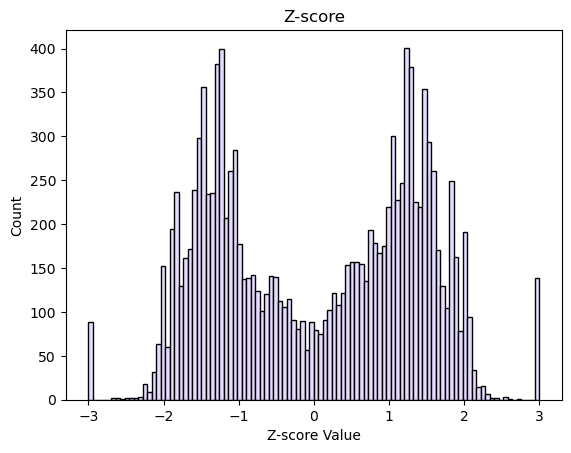

Outliner's count : 228.00


In [37]:
plt.hist(zList, bins=100, color='#e5dbff', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

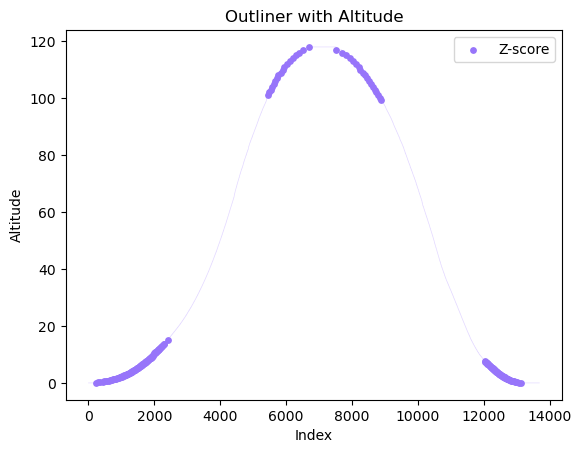

In [38]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df2.index, df2['altitude'], color='#e5dbff',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#9775fa', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df2, THRESHOLD = 3

In [39]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 3  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10234
Detected outlier with : 0.00
------------------------------------------------------------------
index: 233
Mean : 0.02
Std : 0.04
Z-score : 2.05
Altitude : 0.10673
Detected outlier with : 0.00
------------------------------------------------------------------
index: 234
Mean : 0.03
Std : 0.05
Z-score : 1.47
Altitude : 0.10078
Detected outlier with : 0.00
------------------------------------------------------------------
index: 235
Mean : 0.04
Std : 0.05
Z-score : 1.20
Altitude : 0.10143
Detected outlier with : 0.00
------------------------------------------------------------------
index: 236
Mean : 0.05
Std : 0.05
Z-score : 1.11
Altitude : 0.10974
Detected outlier with : 0.00
------------------------------------------------------------------
index: 237
Mean : 0.06
Std : 0.05
Z-score : 0.76
Altitude : 0.10088
Detected outlier with : 0.00
------------------------------------------------------------------
index: 238
Mean 

index: 2698
Mean : 19.29
Std : 0.06
Z-score : 2.06
Altitude : 19.40991
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2699
Mean : 19.31
Std : 0.06
Z-score : 1.63
Altitude : 19.40570
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2700
Mean : 19.34
Std : 0.05
Z-score : 1.54
Altitude : 19.40907
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2701
Mean : 19.35
Std : 0.05
Z-score : 1.25
Altitude : 19.40999
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2702
Mean : 19.36
Std : 0.05
Z-score : 0.95
Altitude : 19.40555
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2703
Mean : 19.37
Std : 0.05
Z-score : 0.81
Altitude : 19.40751
Detected outlier with : 0.00
-----------------------------------------------------------------

index: 5870
Mean : 109.00
Std : 0.00
Z-score : -0.20
Altitude : 109.00301
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5871
Mean : 109.00
Std : 0.00
Z-score : 1.62
Altitude : 109.00858
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5872
Mean : 109.00
Std : 0.00
Z-score : 0.08
Altitude : 109.00493
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5873
Mean : 109.01
Std : 0.00
Z-score : 0.92
Altitude : 109.00709
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5874
Mean : 109.01
Std : 0.00
Z-score : -1.05
Altitude : 109.00348
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5875
Mean : 109.01
Std : 0.00
Z-score : -1.41
Altitude : 109.00244
Detected outlier with : 0.00
--------------------------------------------------

index: 7777
Mean : 116.00
Std : 0.00
Z-score : -0.63
Altitude : 116.00247
Detected outlier with : 0.00
------------------------------------------------------------------
index: 7778
Mean : 116.00
Std : 0.00
Z-score : -0.40
Altitude : 116.00267
Detected outlier with : 0.00
------------------------------------------------------------------
index: 7779
Mean : 116.00
Std : 0.00
Z-score : -0.69
Altitude : 116.00176
Detected outlier with : 0.00
------------------------------------------------------------------
index: 7780
Mean : 116.00
Std : 0.00
Z-score : 2.39
Altitude : 116.00980
Detected outlier with : 0.00
------------------------------------------------------------------
index: 7781
Mean : 116.00
Std : 0.00
Z-score : 0.71
Altitude : 116.00541
Detected outlier with : 0.00
------------------------------------------------------------------
index: 7782
Mean : 116.00
Std : 0.00
Z-score : 1.12
Altitude : 116.00721
Detected outlier with : 0.00
--------------------------------------------------

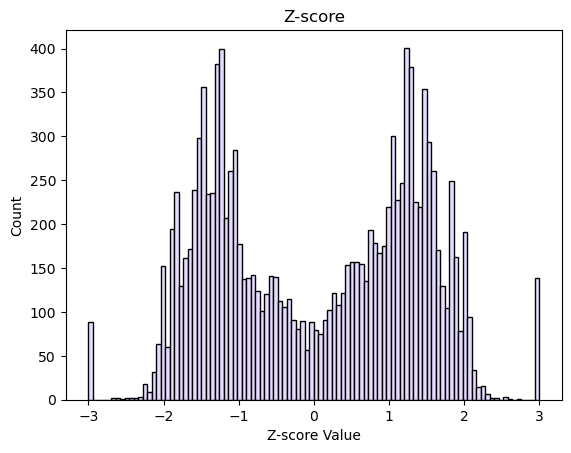

Outliner's count : 0.00


In [40]:
plt.hist(zList, bins=100, color='#e5dbff', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

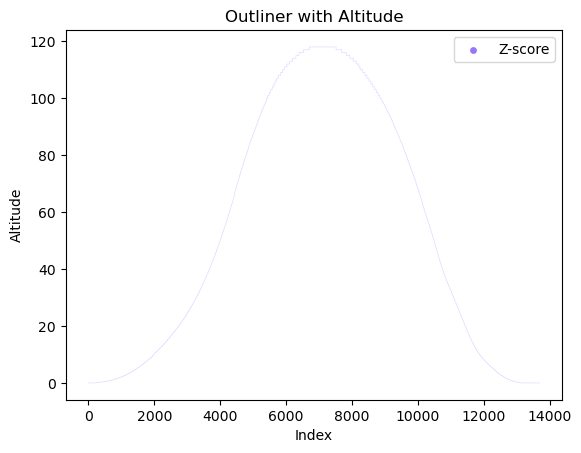

In [41]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df2.index, df2['altitude'], color='#e5dbff',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#9775fa', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df3, THRESHOLDE=2.9

In [11]:
datas = df3['altitude']

#Check all dataframe's Nan.
nan_check = datas.isna().any().any()

if nan_check:
    print("NaN 값이 존재합니다.")
else:
    print("NaN 값이 없습니다.")
print("------------------------------------------")

#Add radom decimal point
for i in range(0, len(datas)):
    if(datas[i] != 0):
        datas[i] = datas[i] + random.uniform(0.0001, 0.01)

datas

NaN 값이 없습니다.
------------------------------------------


0          0.000000
1          0.000000
2          0.000000
3          0.000000
4          0.000000
            ...    
15190    207.006390
15191    207.000343
15192    207.002879
15193    207.001031
15194    207.006759
Name: altitude, Length: 15195, dtype: float64

In [18]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2.9  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10261
Detected outlier with : 1.00
------------------------------------------------------------------
index: 233
Mean : 0.02
Std : 0.04
Z-score : 2.02
Altitude : 0.10386
Detected outlier with : 1.00
------------------------------------------------------------------
index: 234
Mean : 0.03
Std : 0.05
Z-score : 1.51
Altitude : 0.10215
Detected outlier with : 1.00
------------------------------------------------------------------
index: 235
Mean : 0.04
Std : 0.05
Z-score : 1.27
Altitude : 0.10593
Detected outlier with : 1.00
------------------------------------------------------------------
index: 236
Mean : 0.05
Std : 0.05
Z-score : 0.96
Altitude : 0.10136
Detected outlier with : 1.00
------------------------------------------------------------------
index: 237
Mean : 0.06
Std : 0.05
Z-score : 0.80
Altitude : 0.10220
Detected outlier with : 1.00
------------------------------------------------------------------
index: 238
Mean 

index: 4023
Mean : 50.76
Std : 0.10
Z-score : 1.47
Altitude : 50.90592
Detected outlier with : 121.00
------------------------------------------------------------------
index: 4024
Mean : 50.79
Std : 0.10
Z-score : 1.20
Altitude : 50.90136
Detected outlier with : 121.00
------------------------------------------------------------------
index: 4025
Mean : 50.83
Std : 0.10
Z-score : 1.85
Altitude : 51.00354
Detected outlier with : 121.00
------------------------------------------------------------------
index: 4026
Mean : 50.85
Std : 0.10
Z-score : 1.45
Altitude : 51.00037
Detected outlier with : 121.00
------------------------------------------------------------------
index: 4027
Mean : 50.88
Std : 0.10
Z-score : 1.22
Altitude : 51.00052
Detected outlier with : 121.00
------------------------------------------------------------------
index: 4028
Mean : 50.92
Std : 0.10
Z-score : 1.86
Altitude : 51.10290
Detected outlier with : 121.00
-----------------------------------------------------

index: 10612
Mean : 45.11
Std : 0.12
Z-score : -1.67
Altitude : 44.90821
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10613
Mean : 45.07
Std : 0.11
Z-score : -1.45
Altitude : 44.90531
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10614
Mean : 45.04
Std : 0.11
Z-score : -1.17
Altitude : 44.90902
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10615
Mean : 45.00
Std : 0.11
Z-score : -1.68
Altitude : 44.80823
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10616
Mean : 44.96
Std : 0.10
Z-score : -1.48
Altitude : 44.80527
Detected outlier with : 158.00
------------------------------------------------------------------
index: 10617
Mean : 44.92
Std : 0.11
Z-score : -1.88
Altitude : 44.70279
Detected outlier with : 158.00
-----------------------------------------

index: 13684
Mean : 20.80
Std : 62.40
Z-score : 3.00
Altitude : 208.00272
Detected outlier with : 229.00
------------------------------------------------------------------
index: 13685
Mean : 41.60
Std : 83.20
Z-score : 2.00
Altitude : 208.00445
Detected outlier with : 229.00
------------------------------------------------------------------
index: 13686
Mean : 62.40
Std : 95.32
Z-score : 1.53
Altitude : 208.00764
Detected outlier with : 229.00
------------------------------------------------------------------
index: 13687
Mean : 83.20
Std : 101.90
Z-score : 1.22
Altitude : 208.00244
Detected outlier with : 229.00
------------------------------------------------------------------
index: 13688
Mean : 104.00
Std : 104.00
Z-score : 1.00
Altitude : 208.00390
Detected outlier with : 229.00
------------------------------------------------------------------
index: 13689
Mean : 124.80
Std : 101.90
Z-score : 0.82
Altitude : 208.00721
Detected outlier with : 229.00
------------------------------

index: 14525
Mean : 207.00
Std : 0.00
Z-score : 1.05
Altitude : 207.00789
Detected outlier with : 230.00
------------------------------------------------------------------
index: 14526
Mean : 207.00
Std : 0.00
Z-score : 0.87
Altitude : 207.00791
Detected outlier with : 230.00
------------------------------------------------------------------
index: 14527
Mean : 207.00
Std : 0.00
Z-score : 1.01
Altitude : 207.00823
Detected outlier with : 230.00
------------------------------------------------------------------
index: 14528
Mean : 207.00
Std : 0.00
Z-score : -1.30
Altitude : 207.00048
Detected outlier with : 230.00
------------------------------------------------------------------
index: 14529
Mean : 207.01
Std : 0.00
Z-score : 0.11
Altitude : 207.00564
Detected outlier with : 230.00
------------------------------------------------------------------
index: 14530
Mean : 207.01
Std : 0.00
Z-score : 1.09
Altitude : 207.00944
Detected outlier with : 230.00
----------------------------------

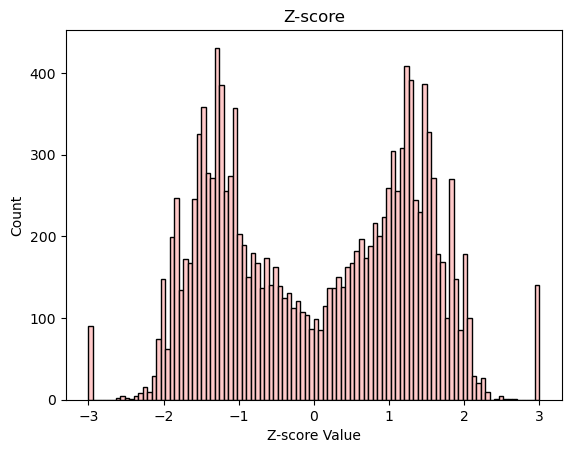

Outliner's count : 230.00


In [19]:
plt.hist(zList,bins=100, color='#ffc9c9', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

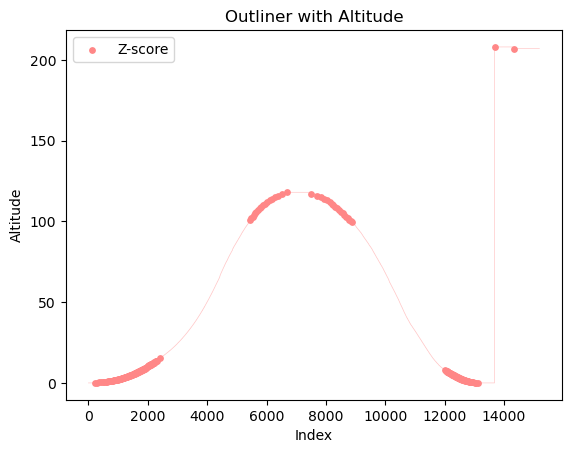

In [20]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['altitude'], color='#ffc9c9',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#ff8787', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df3, THRESHOLDE=3

In [54]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 3  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10270
Detected outlier with : 0.00
------------------------------------------------------------------
index: 233
Mean : 0.02
Std : 0.04
Z-score : 2.06
Altitude : 0.10821
Detected outlier with : 0.00
------------------------------------------------------------------
index: 234
Mean : 0.03
Std : 0.05
Z-score : 1.57
Altitude : 0.10888
Detected outlier with : 0.00
------------------------------------------------------------------
index: 235
Mean : 0.04
Std : 0.05
Z-score : 1.19
Altitude : 0.10398
Detected outlier with : 0.00
------------------------------------------------------------------
index: 236
Mean : 0.05
Std : 0.05
Z-score : 1.00
Altitude : 0.10609
Detected outlier with : 0.00
------------------------------------------------------------------
index: 237
Mean : 0.06
Std : 0.05
Z-score : 0.87
Altitude : 0.10910
Detected outlier with : 0.00
------------------------------------------------------------------
index: 238
Mean 

index: 975
Mean : 2.01
Std : 0.00
Z-score : 0.92
Altitude : 2.00829
Detected outlier with : 0.00
------------------------------------------------------------------
index: 976
Mean : 2.01
Std : 0.00
Z-score : -1.42
Altitude : 2.00116
Detected outlier with : 0.00
------------------------------------------------------------------
index: 977
Mean : 2.01
Std : 0.00
Z-score : 0.68
Altitude : 2.00755
Detected outlier with : 0.00
------------------------------------------------------------------
index: 978
Mean : 2.00
Std : 0.00
Z-score : -1.16
Altitude : 2.00126
Detected outlier with : 0.00
------------------------------------------------------------------
index: 979
Mean : 2.00
Std : 0.00
Z-score : -1.04
Altitude : 2.00205
Detected outlier with : 0.00
------------------------------------------------------------------
index: 980
Mean : 2.01
Std : 0.00
Z-score : 0.80
Altitude : 2.00739
Detected outlier with : 0.00
------------------------------------------------------------------
index: 981
Me

index: 2917
Mean : 22.86
Std : 0.05
Z-score : 1.05
Altitude : 22.90766
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2918
Mean : 22.87
Std : 0.05
Z-score : 0.80
Altitude : 22.90437
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2919
Mean : 22.89
Std : 0.06
Z-score : 2.05
Altitude : 23.00975
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2920
Mean : 22.91
Std : 0.06
Z-score : 1.57
Altitude : 23.00541
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2921
Mean : 22.93
Std : 0.06
Z-score : 1.27
Altitude : 23.00065
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2922
Mean : 22.94
Std : 0.05
Z-score : 1.17
Altitude : 23.00181
Detected outlier with : 0.00
-----------------------------------------------------------------

index: 3922
Mean : 47.38
Std : 0.10
Z-score : 1.20
Altitude : 47.50245
Detected outlier with : 0.00
------------------------------------------------------------------
index: 3923
Mean : 47.42
Std : 0.10
Z-score : 1.86
Altitude : 47.60899
Detected outlier with : 0.00
------------------------------------------------------------------
index: 3924
Mean : 47.45
Std : 0.10
Z-score : 1.45
Altitude : 47.60562
Detected outlier with : 0.00
------------------------------------------------------------------
index: 3925
Mean : 47.48
Std : 0.10
Z-score : 1.20
Altitude : 47.60361
Detected outlier with : 0.00
------------------------------------------------------------------
index: 3926
Mean : 47.53
Std : 0.10
Z-score : 1.85
Altitude : 47.70789
Detected outlier with : 0.00
------------------------------------------------------------------
index: 3927
Mean : 47.56
Std : 0.10
Z-score : 1.47
Altitude : 47.70865
Detected outlier with : 0.00
-----------------------------------------------------------------

index: 8168
Mean : 112.00
Std : 0.00
Z-score : -1.05
Altitude : 112.00134
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8169
Mean : 112.00
Std : 0.00
Z-score : 0.67
Altitude : 112.00578
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8170
Mean : 112.00
Std : 0.00
Z-score : -1.40
Altitude : 112.00055
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8171
Mean : 112.00
Std : 0.00
Z-score : 0.75
Altitude : 112.00543
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8172
Mean : 112.00
Std : 0.00
Z-score : 1.66
Altitude : 112.00876
Detected outlier with : 0.00
------------------------------------------------------------------
index: 8173
Mean : 112.00
Std : 0.00
Z-score : -0.03
Altitude : 112.00471
Detected outlier with : 0.00
--------------------------------------------------

index: 12859
Mean : 0.71
Std : 0.03
Z-score : -0.46
Altitude : 0.70029
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12860
Mean : 0.70
Std : 0.00
Z-score : -1.01
Altitude : 0.70098
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12861
Mean : 0.70
Std : 0.00
Z-score : 1.03
Altitude : 0.70757
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12862
Mean : 0.70
Std : 0.00
Z-score : 1.23
Altitude : 0.70873
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12863
Mean : 0.70
Std : 0.00
Z-score : 0.21
Altitude : 0.70515
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12864
Mean : 0.70
Std : 0.00
Z-score : -1.19
Altitude : 0.70070
Detected outlier with : 0.00
------------------------------------------------------------------
i

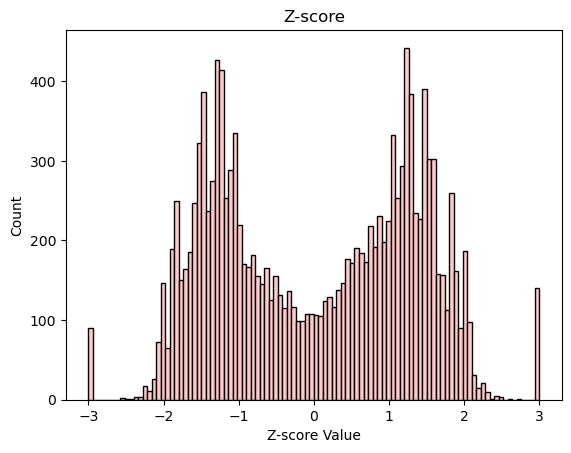

Outliner's count : 0.00


In [56]:
plt.hist(zList, bins=100, color='#ffc9c9', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')
plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

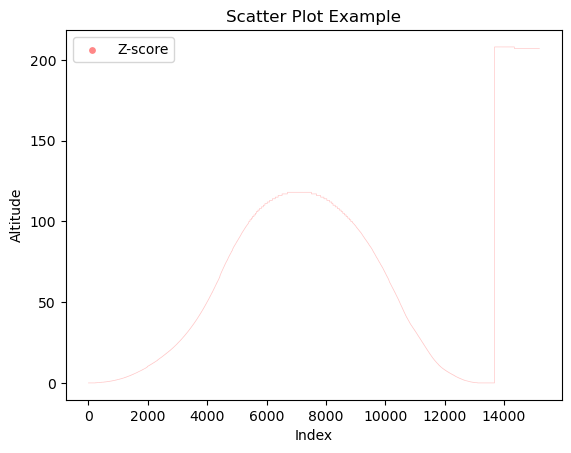

In [57]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['altitude'], color='#ffc9c9',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#ff8787', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Scatter Plot Example')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### 이상치를 THREDSHOLD가 2.9일 땐 발견하지만 3.0일 땐 발견하지 못함
### WINDOW 변경 추가 실험
### 2.9<= T <= 3.0 로 추가 실험

### df3, WINDOW = 100, THRESHOLD = 9 (WINDOW 수와 Zscore 비례) 

In [65]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 100
THRESHOLD = 9  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.00
Std : 0.01
Z-score : 9.95
Altitude : 0.10261
Detected outlier with : 1.00
------------------------------------------------------------------
index: 233
Mean : 0.00
Std : 0.01
Z-score : 7.04
Altitude : 0.10386
Detected outlier with : 1.00
------------------------------------------------------------------
index: 234
Mean : 0.00
Std : 0.02
Z-score : 5.65
Altitude : 0.10215
Detected outlier with : 1.00
------------------------------------------------------------------
index: 235
Mean : 0.00
Std : 0.02
Z-score : 5.01
Altitude : 0.10593
Detected outlier with : 1.00
------------------------------------------------------------------
index: 236
Mean : 0.01
Std : 0.02
Z-score : 4.28
Altitude : 0.10136
Detected outlier with : 1.00
------------------------------------------------------------------
index: 237
Mean : 0.01
Std : 0.02
Z-score : 3.92
Altitude : 0.10220
Detected outlier with : 1.00
------------------------------------------------------------------
index: 238
Mean 

index: 3652
Mean : 38.05
Std : 0.77
Z-score : 1.75
Altitude : 39.40352
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3653
Mean : 38.08
Std : 0.77
Z-score : 1.71
Altitude : 39.40082
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3654
Mean : 38.10
Std : 0.78
Z-score : 1.68
Altitude : 39.40982
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3655
Mean : 38.13
Std : 0.77
Z-score : 1.65
Altitude : 39.40936
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3656
Mean : 38.16
Std : 0.78
Z-score : 1.74
Altitude : 39.50582
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3657
Mean : 38.18
Std : 0.77
Z-score : 1.71
Altitude : 39.50810
Detected outlier with : 1.00
-----------------------------------------------------------------

index: 6993
Mean : 118.00
Std : 0.00
Z-score : -0.56
Altitude : 118.00337
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6994
Mean : 118.00
Std : 0.00
Z-score : 1.66
Altitude : 118.00956
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6995
Mean : 118.00
Std : 0.00
Z-score : -0.74
Altitude : 118.00286
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6996
Mean : 118.00
Std : 0.00
Z-score : 1.20
Altitude : 118.00822
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6997
Mean : 118.00
Std : 0.00
Z-score : 0.10
Altitude : 118.00516
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6998
Mean : 118.00
Std : 0.00
Z-score : 0.15
Altitude : 118.00533
Detected outlier with : 4.00
---------------------------------------------------

index: 11290
Mean : 25.52
Std : 0.84
Z-score : -1.69
Altitude : 24.10651
Detected outlier with : 8.00
------------------------------------------------------------------
index: 11291
Mean : 25.49
Std : 0.84
Z-score : -1.77
Altitude : 24.00831
Detected outlier with : 8.00
------------------------------------------------------------------
index: 11292
Mean : 25.46
Std : 0.84
Z-score : -1.74
Altitude : 24.00517
Detected outlier with : 8.00
------------------------------------------------------------------
index: 11293
Mean : 25.43
Std : 0.84
Z-score : -1.70
Altitude : 24.00953
Detected outlier with : 8.00
------------------------------------------------------------------
index: 11294
Mean : 25.40
Std : 0.83
Z-score : -1.67
Altitude : 24.00916
Detected outlier with : 8.00
------------------------------------------------------------------
index: 11295
Mean : 25.37
Std : 0.84
Z-score : -1.76
Altitude : 23.90583
Detected outlier with : 8.00
-----------------------------------------------------

index: 12593
Mean : 2.58
Std : 0.23
Z-score : -1.63
Altitude : 2.20882
Detected outlier with : 8.00
------------------------------------------------------------------
index: 12594
Mean : 2.57
Std : 0.23
Z-score : -1.62
Altitude : 2.20505
Detected outlier with : 8.00
------------------------------------------------------------------
index: 12595
Mean : 2.57
Std : 0.23
Z-score : -1.58
Altitude : 2.20904
Detected outlier with : 8.00
------------------------------------------------------------------
index: 12596
Mean : 2.56
Std : 0.22
Z-score : -1.58
Altitude : 2.20148
Detected outlier with : 8.00
------------------------------------------------------------------
index: 12597
Mean : 2.55
Std : 0.22
Z-score : -1.53
Altitude : 2.20746
Detected outlier with : 8.00
------------------------------------------------------------------
index: 12598
Mean : 2.54
Std : 0.23
Z-score : -1.93
Altitude : 2.10597
Detected outlier with : 8.00
-----------------------------------------------------------------

index: 13819
Mean : 208.00
Std : 0.00
Z-score : -0.17
Altitude : 208.00449
Detected outlier with : 9.00
------------------------------------------------------------------
index: 13820
Mean : 208.00
Std : 0.00
Z-score : -0.74
Altitude : 208.00295
Detected outlier with : 9.00
------------------------------------------------------------------
index: 13821
Mean : 208.00
Std : 0.00
Z-score : -1.39
Altitude : 208.00114
Detected outlier with : 9.00
------------------------------------------------------------------
index: 13822
Mean : 208.00
Std : 0.00
Z-score : 0.35
Altitude : 208.00585
Detected outlier with : 9.00
------------------------------------------------------------------
index: 13823
Mean : 208.00
Std : 0.00
Z-score : -1.13
Altitude : 208.00185
Detected outlier with : 9.00
------------------------------------------------------------------
index: 13824
Mean : 208.00
Std : 0.00
Z-score : 1.04
Altitude : 208.00764
Detected outlier with : 9.00
-------------------------------------------

In [66]:
max(zList)

9.9498743710662

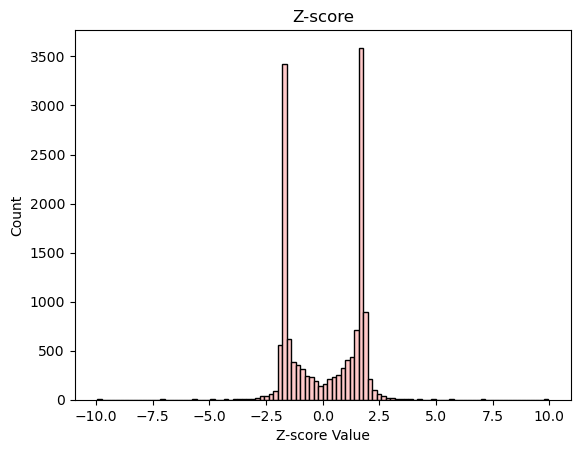

Outliner's count : 10.00


In [67]:
plt.hist(zList, bins=100, color='#ffc9c9', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')
plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

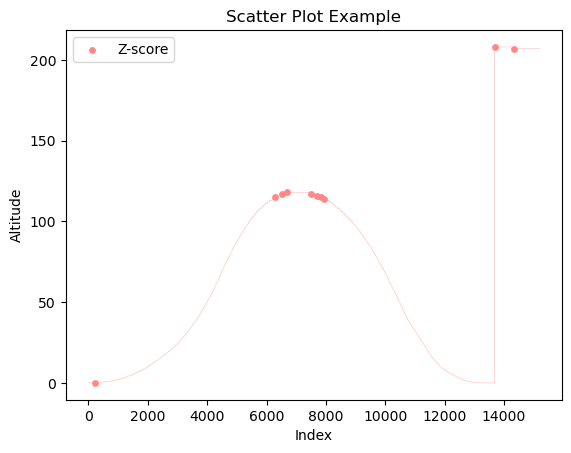

In [68]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['altitude'], color='#ffc9c9',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#ff8787', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Scatter Plot Example')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

### df3, abs(z) >= 3.0

In [67]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 3  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) >= THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 232
Mean : 0.01
Std : 0.03
Z-score : 3.00
Altitude : 0.10270
Detected outlier with : 1.00
------------------------------------------------------------------
index: 233
Mean : 0.02
Std : 0.04
Z-score : 2.06
Altitude : 0.10821
Detected outlier with : 1.00
------------------------------------------------------------------
index: 234
Mean : 0.03
Std : 0.05
Z-score : 1.57
Altitude : 0.10888
Detected outlier with : 1.00
------------------------------------------------------------------
index: 235
Mean : 0.04
Std : 0.05
Z-score : 1.19
Altitude : 0.10398
Detected outlier with : 1.00
------------------------------------------------------------------
index: 236
Mean : 0.05
Std : 0.05
Z-score : 1.00
Altitude : 0.10609
Detected outlier with : 1.00
------------------------------------------------------------------
index: 237
Mean : 0.06
Std : 0.05
Z-score : 0.87
Altitude : 0.10910
Detected outlier with : 1.00
------------------------------------------------------------------
index: 238
Mean 

index: 3626
Mean : 38.56
Std : 0.08
Z-score : 1.85
Altitude : 38.70083
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3627
Mean : 38.58
Std : 0.07
Z-score : 1.61
Altitude : 38.70184
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3628
Mean : 38.60
Std : 0.08
Z-score : 1.32
Altitude : 38.70507
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3629
Mean : 38.62
Std : 0.07
Z-score : 1.10
Altitude : 38.70579
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3630
Mean : 38.65
Std : 0.08
Z-score : 1.91
Altitude : 38.80785
Detected outlier with : 1.00
------------------------------------------------------------------
index: 3631
Mean : 38.68
Std : 0.08
Z-score : 1.64
Altitude : 38.80955
Detected outlier with : 1.00
-----------------------------------------------------------------

index: 5843
Mean : 109.00
Std : 0.00
Z-score : -1.29
Altitude : 109.00132
Detected outlier with : 1.00
------------------------------------------------------------------
index: 5844
Mean : 109.01
Std : 0.00
Z-score : 1.33
Altitude : 109.00879
Detected outlier with : 1.00
------------------------------------------------------------------
index: 5845
Mean : 109.01
Std : 0.00
Z-score : 0.14
Altitude : 109.00547
Detected outlier with : 1.00
------------------------------------------------------------------
index: 5846
Mean : 109.01
Std : 0.00
Z-score : -0.60
Altitude : 109.00333
Detected outlier with : 1.00
------------------------------------------------------------------
index: 5847
Mean : 109.00
Std : 0.00
Z-score : 0.91
Altitude : 109.00750
Detected outlier with : 1.00
------------------------------------------------------------------
index: 5848
Mean : 109.00
Std : 0.00
Z-score : 0.03
Altitude : 109.00492
Detected outlier with : 1.00
---------------------------------------------------

index: 7613
Mean : 117.01
Std : 0.00
Z-score : -0.28
Altitude : 117.00609
Detected outlier with : 1.00
------------------------------------------------------------------
index: 7614
Mean : 117.01
Std : 0.00
Z-score : -0.53
Altitude : 117.00541
Detected outlier with : 1.00
------------------------------------------------------------------
index: 7615
Mean : 117.01
Std : 0.00
Z-score : 0.05
Altitude : 117.00681
Detected outlier with : 1.00
------------------------------------------------------------------
index: 7616
Mean : 117.01
Std : 0.00
Z-score : 0.46
Altitude : 117.00766
Detected outlier with : 1.00
------------------------------------------------------------------
index: 7617
Mean : 117.01
Std : 0.00
Z-score : -0.83
Altitude : 117.00404
Detected outlier with : 1.00
------------------------------------------------------------------
index: 7618
Mean : 117.01
Std : 0.00
Z-score : -0.21
Altitude : 117.00512
Detected outlier with : 1.00
-------------------------------------------------

index: 9784
Mean : 75.50
Std : 0.08
Z-score : -1.10
Altitude : 75.40523
Detected outlier with : 1.00
------------------------------------------------------------------
index: 9785
Mean : 75.47
Std : 0.09
Z-score : -1.75
Altitude : 75.30740
Detected outlier with : 1.00
------------------------------------------------------------------
index: 9786
Mean : 75.44
Std : 0.09
Z-score : -1.48
Altitude : 75.30201
Detected outlier with : 1.00
------------------------------------------------------------------
index: 9787
Mean : 75.41
Std : 0.08
Z-score : -1.26
Altitude : 75.30884
Detected outlier with : 1.00
------------------------------------------------------------------
index: 9788
Mean : 75.38
Std : 0.09
Z-score : -1.88
Altitude : 75.20757
Detected outlier with : 1.00
------------------------------------------------------------------
index: 9789
Mean : 75.35
Std : 0.09
Z-score : -1.53
Altitude : 75.20537
Detected outlier with : 1.00
-----------------------------------------------------------

index: 14868
Mean : 207.01
Std : 0.00
Z-score : 1.50
Altitude : 207.00854
Detected outlier with : 2.00
------------------------------------------------------------------
index: 14869
Mean : 207.01
Std : 0.00
Z-score : 0.11
Altitude : 207.00593
Detected outlier with : 2.00
------------------------------------------------------------------
index: 14870
Mean : 207.01
Std : 0.00
Z-score : -1.88
Altitude : 207.00114
Detected outlier with : 2.00
------------------------------------------------------------------
index: 14871
Mean : 207.01
Std : 0.00
Z-score : 0.67
Altitude : 207.00652
Detected outlier with : 2.00
------------------------------------------------------------------
index: 14872
Mean : 207.01
Std : 0.00
Z-score : -0.12
Altitude : 207.00491
Detected outlier with : 2.00
------------------------------------------------------------------
index: 14873
Mean : 207.01
Std : 0.00
Z-score : 1.52
Altitude : 207.00905
Detected outlier with : 2.00
---------------------------------------------

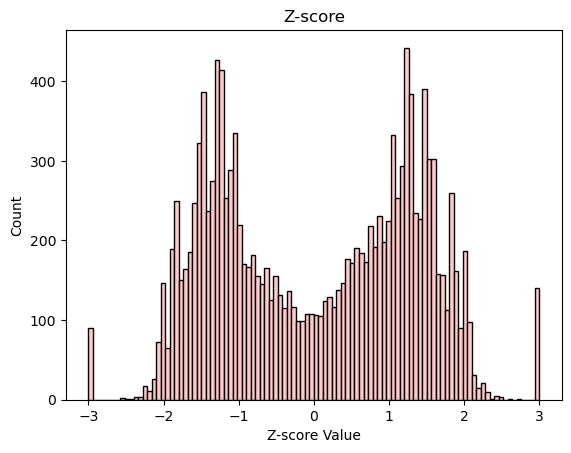

Outliner's count : 2.00


In [68]:
plt.hist(zList, bins=100, color='#ffc9c9', edgecolor='black')  # bins는 구간의 개수를 나타냄
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')
plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

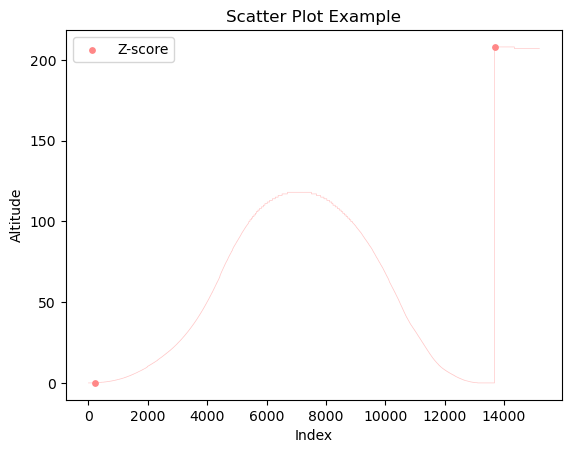

In [69]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['altitude'], color='#ffc9c9',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#ff8787', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Scatter Plot Example')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

## Add custom data
### 이상치 포함 데이터 df4

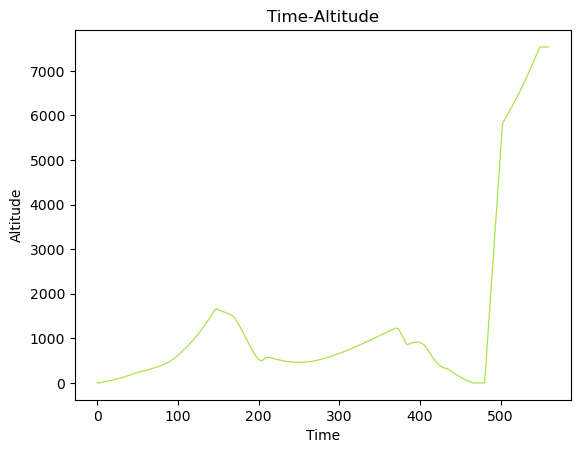

In [72]:
plt.plot(df3['time'], df3['velocity'], color='#a9e34b', lw=0.9)
plt.title('Time-Altitude')
plt.xlabel('Time')
plt.ylabel('Altitude')

plt.show()

In [75]:
datas = df3['velocity']

#Check all dataframe's Nan.
nan_check = datas.isna().any().any()

if nan_check:
    print("NaN 값이 존재합니다.")
else:
    print("NaN 값이 없습니다.")
print("------------------------------------------")

datas

NaN 값이 없습니다.
------------------------------------------


0           0.000000
1           0.282070
2           0.562765
3           0.558353
4           0.560899
            ...     
15190    7537.506022
15191    7537.506152
15192    7537.506522
15193    7537.506391
15194    7537.504092
Name: velocity, Length: 15195, dtype: float64

### df4, abs(z) >= 3.0

In [76]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 3  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) >= THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 9
Mean : 0.59
Std : 0.26
Z-score : 0.95
Altitude : 0.83659
Detected outlier with : 0.00
------------------------------------------------------------------
index: 10
Mean : 0.70
Std : 0.22
Z-score : 1.86
Altitude : 1.11184
Detected outlier with : 0.00
------------------------------------------------------------------
index: 11
Mean : 0.78
Std : 0.21
Z-score : 1.62
Altitude : 1.11611
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12
Mean : 0.84
Std : 0.21
Z-score : 1.29
Altitude : 1.11410
Detected outlier with : 0.00
------------------------------------------------------------------
index: 13
Mean : 0.89
Std : 0.21
Z-score : 1.09
Altitude : 1.12026
Detected outlier with : 0.00
------------------------------------------------------------------
index: 14
Mean : 0.98
Std : 0.22
Z-score : 1.87
Altitude : 1.39735
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15
Mean : 1.06
S

index: 2968
Mean : 660.00
Std : 1.60
Z-score : 1.57
Altitude : 662.50481
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2969
Mean : 660.56
Std : 1.60
Z-score : 1.57
Altitude : 663.06310
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2970
Mean : 661.12
Std : 1.60
Z-score : 1.57
Altitude : 663.61535
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2971
Mean : 661.67
Std : 1.60
Z-score : 1.57
Altitude : 664.17452
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2972
Mean : 662.23
Std : 1.60
Z-score : 1.57
Altitude : 664.72700
Detected outlier with : 0.00
------------------------------------------------------------------
index: 2973
Mean : 662.76
Std : 1.55
Z-score : 1.45
Altitude : 665.00795
Detected outlier with : 0.00
-----------------------------------------------------

index: 5938
Mean : 558.56
Std : 1.00
Z-score : 1.44
Altitude : 560.00384
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5939
Mean : 558.89
Std : 0.96
Z-score : 1.44
Altitude : 560.27878
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5940
Mean : 559.23
Std : 0.90
Z-score : 1.48
Altitude : 560.56108
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5941
Mean : 559.53
Std : 0.88
Z-score : 1.48
Altitude : 560.83399
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5942
Mean : 559.84
Std : 0.84
Z-score : 1.52
Altitude : 561.11945
Detected outlier with : 0.00
------------------------------------------------------------------
index: 5943
Mean : 560.14
Std : 0.80
Z-score : 1.57
Altitude : 561.39314
Detected outlier with : 0.00
-----------------------------------------------------

index: 6961
Mean : 463.78
Std : 0.14
Z-score : -1.25
Altitude : 463.61145
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6962
Mean : 463.75
Std : 0.14
Z-score : -0.97
Altitude : 463.62048
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6963
Mean : 463.73
Std : 0.13
Z-score : -0.81
Altitude : 463.61681
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6964
Mean : 463.70
Std : 0.13
Z-score : -0.67
Altitude : 463.61436
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6965
Mean : 463.67
Std : 0.11
Z-score : -0.46
Altitude : 463.62095
Detected outlier with : 0.00
------------------------------------------------------------------
index: 6966
Mean : 463.62
Std : 0.12
Z-score : -2.26
Altitude : 463.33798
Detected outlier with : 0.00
-----------------------------------------------

index: 12574
Mean : 228.89
Std : 1.16
Z-score : -1.67
Altitude : 226.95082
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12575
Mean : 228.50
Std : 1.19
Z-score : -1.54
Altitude : 226.66846
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12576
Mean : 228.11
Std : 1.18
Z-score : -1.46
Altitude : 226.38822
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12577
Mean : 227.70
Std : 1.18
Z-score : -1.58
Altitude : 225.83774
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12578
Mean : 227.28
Std : 1.22
Z-score : -1.63
Altitude : 225.28690
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12579
Mean : 226.86
Std : 1.22
Z-score : -1.53
Altitude : 225.00168
Detected outlier with : 0.00
-----------------------------------------

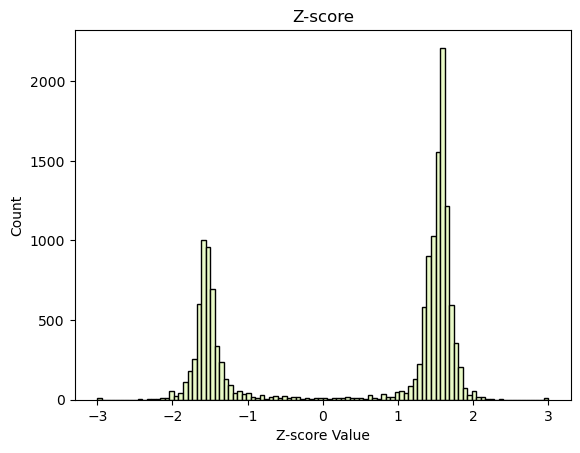

Outliner's count : 1.00


In [78]:
plt.hist(zList, bins=100, color='#e9fac8', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

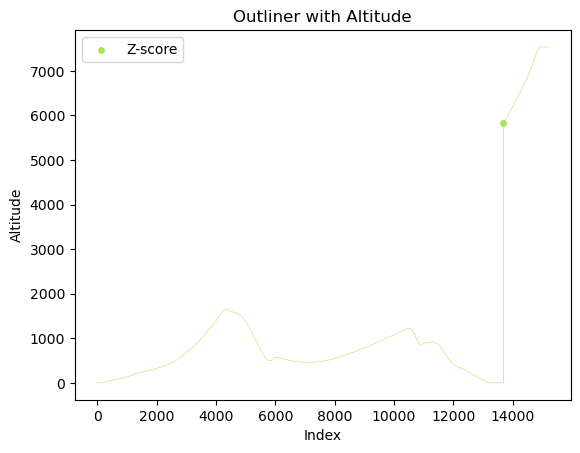

In [81]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['velocity'], color='#c0eb75',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#a9e34b', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

## df4, THRESHOLD=2.9 ( abs(z) > 2.9 )

In [94]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2.9  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 9
Mean : 0.59
Std : 0.26
Z-score : 0.95
Altitude : 0.83659
Detected outlier with : 0.00
------------------------------------------------------------------
index: 10
Mean : 0.70
Std : 0.22
Z-score : 1.86
Altitude : 1.11184
Detected outlier with : 0.00
------------------------------------------------------------------
index: 11
Mean : 0.78
Std : 0.21
Z-score : 1.62
Altitude : 1.11611
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12
Mean : 0.84
Std : 0.21
Z-score : 1.29
Altitude : 1.11410
Detected outlier with : 0.00
------------------------------------------------------------------
index: 13
Mean : 0.89
Std : 0.21
Z-score : 1.09
Altitude : 1.12026
Detected outlier with : 0.00
------------------------------------------------------------------
index: 14
Mean : 0.98
Std : 0.22
Z-score : 1.87
Altitude : 1.39735
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15
Mean : 1.06
S

index: 1159
Mean : 170.09
Std : 0.61
Z-score : 1.69
Altitude : 171.11993
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1160
Mean : 170.28
Std : 0.60
Z-score : 1.40
Altitude : 171.11866
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1161
Mean : 170.48
Std : 0.61
Z-score : 1.51
Altitude : 171.39745
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1162
Mean : 170.70
Std : 0.60
Z-score : 1.62
Altitude : 171.67300
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1163
Mean : 170.89
Std : 0.57
Z-score : 1.37
Altitude : 171.66892
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1164
Mean : 171.09
Std : 0.56
Z-score : 1.53
Altitude : 171.94508
Detected outlier with : 2.00
-----------------------------------------------------

index: 4803
Mean : 1529.06
Std : 1.21
Z-score : -1.75
Altitude : 1526.94978
Detected outlier with : 2.00
------------------------------------------------------------------
index: 4804
Mean : 1528.64
Std : 1.24
Z-score : -1.59
Altitude : 1526.66987
Detected outlier with : 2.00
------------------------------------------------------------------
index: 4805
Mean : 1528.23
Std : 1.23
Z-score : -1.50
Altitude : 1526.39216
Detected outlier with : 2.00
------------------------------------------------------------------
index: 4806
Mean : 1527.84
Std : 1.22
Z-score : -1.41
Altitude : 1526.11847
Detected outlier with : 2.00
------------------------------------------------------------------
index: 4807
Mean : 1527.42
Std : 1.21
Z-score : -1.53
Altitude : 1525.56463
Detected outlier with : 2.00
------------------------------------------------------------------
index: 4808
Mean : 1527.00
Std : 1.16
Z-score : -1.49
Altitude : 1525.28344
Detected outlier with : 2.00
-----------------------------------

index: 8368
Mean : 628.09
Std : 0.69
Z-score : 1.58
Altitude : 629.17269
Detected outlier with : 17.00
------------------------------------------------------------------
index: 8369
Mean : 628.31
Std : 0.64
Z-score : 1.35
Altitude : 629.17306
Detected outlier with : 17.00
------------------------------------------------------------------
index: 8370
Mean : 628.56
Std : 0.65
Z-score : 1.78
Altitude : 629.72567
Detected outlier with : 17.00
------------------------------------------------------------------
index: 8371
Mean : 628.78
Std : 0.64
Z-score : 1.49
Altitude : 629.72689
Detected outlier with : 17.00
------------------------------------------------------------------
index: 8372
Mean : 629.00
Std : 0.64
Z-score : 1.57
Altitude : 630.00381
Detected outlier with : 17.00
------------------------------------------------------------------
index: 8373
Mean : 629.23
Std : 0.65
Z-score : 1.61
Altitude : 630.27878
Detected outlier with : 17.00
-----------------------------------------------

index: 10845
Mean : 878.56
Std : 2.49
Z-score : -1.43
Altitude : 875.00285
Detected outlier with : 17.00
------------------------------------------------------------------
index: 10846
Mean : 877.75
Std : 2.47
Z-score : -1.45
Altitude : 874.16905
Detected outlier with : 17.00
------------------------------------------------------------------
index: 10847
Mean : 876.95
Std : 2.38
Z-score : -1.40
Altitude : 873.61957
Detected outlier with : 17.00
------------------------------------------------------------------
index: 10848
Mean : 876.17
Std : 2.15
Z-score : -1.32
Altitude : 873.33750
Detected outlier with : 17.00
------------------------------------------------------------------
index: 10849
Mean : 875.42
Std : 1.98
Z-score : -1.47
Altitude : 872.50329
Detected outlier with : 17.00
------------------------------------------------------------------
index: 10850
Mean : 874.76
Std : 1.82
Z-score : -1.39
Altitude : 872.22973
Detected outlier with : 17.00
-----------------------------------

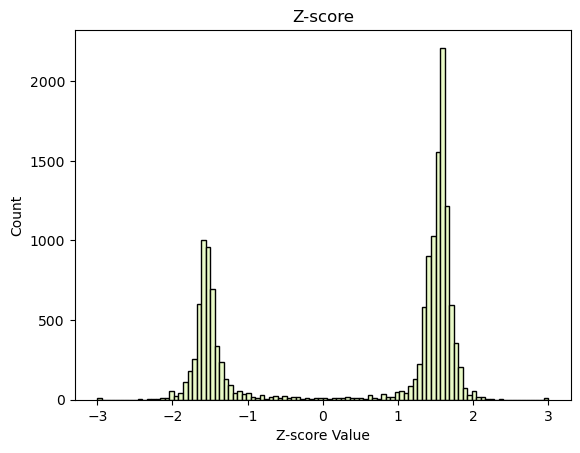

Outliner's count : 25.00


In [95]:
plt.hist(zList, bins=100, color='#e9fac8', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

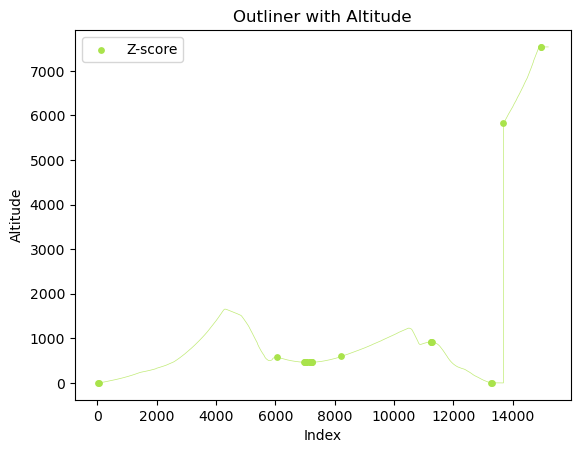

In [96]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['velocity'], color='#c0eb75',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#a9e34b', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

In [88]:
import time
import numpy as np
import datetime
import multiprocessing
import sys
import matplotlib.pyplot as plt

WINDOW = 10
THRESHOLD = 2.5  #이상치 임계값
NO_DEPLOY_ALTITUDE = 1
FALLING_CONFIRMATION = 3

moving_averages = []
falling_count = 0

#plot datas
zList = []
outlinerList = []

for i in range(0, (len(datas) - WINDOW + 1)):
        #Choose altitude 0- WINDOW
        altitude = datas[(i+WINDOW-1)]
        mean = np.mean(datas[(i):(i+WINDOW)])
        std = np.std(datas[(i):(i+WINDOW)])
        if(std != 0):
            z = (altitude-mean)/std 
            zList.append(z)
            print(f"index: {(i+WINDOW-1)}")
            print('Mean : {:.2f}'.format(mean))
            print('Std : {:.2f}'.format(std))
            print('Z-score : {:.2f}'.format(z))
            print('Altitude : {:.5f}'.format(altitude))
            if abs(z) > THRESHOLD: 
                outlinerList.append([(i+WINDOW-1), altitude])
            print('Detected outlier with : {:.2f}'.format(len(outlinerList)))
            print("------------------------------------------------------------------")

index: 9
Mean : 0.59
Std : 0.26
Z-score : 0.95
Altitude : 0.83659
Detected outlier with : 0.00
------------------------------------------------------------------
index: 10
Mean : 0.70
Std : 0.22
Z-score : 1.86
Altitude : 1.11184
Detected outlier with : 0.00
------------------------------------------------------------------
index: 11
Mean : 0.78
Std : 0.21
Z-score : 1.62
Altitude : 1.11611
Detected outlier with : 0.00
------------------------------------------------------------------
index: 12
Mean : 0.84
Std : 0.21
Z-score : 1.29
Altitude : 1.11410
Detected outlier with : 0.00
------------------------------------------------------------------
index: 13
Mean : 0.89
Std : 0.21
Z-score : 1.09
Altitude : 1.12026
Detected outlier with : 0.00
------------------------------------------------------------------
index: 14
Mean : 0.98
Std : 0.22
Z-score : 1.87
Altitude : 1.39735
Detected outlier with : 0.00
------------------------------------------------------------------
index: 15
Mean : 1.06
S

index: 1027
Mean : 143.89
Std : 0.53
Z-score : 1.58
Altitude : 144.72587
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1028
Mean : 144.09
Std : 0.54
Z-score : 1.69
Altitude : 145.00205
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1029
Mean : 144.28
Std : 0.59
Z-score : 1.71
Altitude : 145.27737
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1030
Mean : 144.47
Std : 0.56
Z-score : 1.43
Altitude : 145.27747
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1031
Mean : 144.67
Std : 0.57
Z-score : 1.57
Altitude : 145.55776
Detected outlier with : 2.00
------------------------------------------------------------------
index: 1032
Mean : 144.86
Std : 0.60
Z-score : 1.63
Altitude : 145.84206
Detected outlier with : 2.00
-----------------------------------------------------

index: 3701
Mean : 1138.39
Std : 2.16
Z-score : 1.52
Altitude : 1141.67205
Detected outlier with : 3.00
------------------------------------------------------------------
index: 3702
Mean : 1139.17
Std : 2.20
Z-score : 1.64
Altitude : 1142.78530
Detected outlier with : 3.00
------------------------------------------------------------------
index: 3703
Mean : 1139.92
Std : 2.21
Z-score : 1.55
Altitude : 1143.34107
Detected outlier with : 3.00
------------------------------------------------------------------
index: 3704
Mean : 1140.67
Std : 2.16
Z-score : 1.49
Altitude : 1143.88869
Detected outlier with : 3.00
------------------------------------------------------------------
index: 3705
Mean : 1141.45
Std : 2.18
Z-score : 1.63
Altitude : 1145.00302
Detected outlier with : 3.00
------------------------------------------------------------------
index: 3706
Mean : 1142.23
Std : 2.22
Z-score : 1.63
Altitude : 1145.84193
Detected outlier with : 3.00
-----------------------------------------

index: 6003
Mean : 570.14
Std : 0.42
Z-score : 1.67
Altitude : 570.84163
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6004
Mean : 570.31
Std : 0.44
Z-score : 1.83
Altitude : 571.11328
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6005
Mean : 570.45
Std : 0.45
Z-score : 1.48
Altitude : 571.11952
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6006
Mean : 570.59
Std : 0.42
Z-score : 1.26
Altitude : 571.12087
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6007
Mean : 570.73
Std : 0.43
Z-score : 1.53
Altitude : 571.39106
Detected outlier with : 4.00
------------------------------------------------------------------
index: 6008
Mean : 570.89
Std : 0.44
Z-score : 1.75
Altitude : 571.67332
Detected outlier with : 4.00
-----------------------------------------------------

index: 7130
Mean : 460.56
Std : 0.00
Z-score : -2.30
Altitude : 460.55535
Detected outlier with : 14.00
------------------------------------------------------------------
index: 7131
Mean : 460.56
Std : 0.00
Z-score : 0.03
Altitude : 460.56075
Detected outlier with : 14.00
------------------------------------------------------------------
index: 7132
Mean : 460.56
Std : 0.00
Z-score : -0.98
Altitude : 460.55808
Detected outlier with : 14.00
------------------------------------------------------------------
index: 7133
Mean : 460.56
Std : 0.00
Z-score : 1.48
Altitude : 460.56449
Detected outlier with : 14.00
------------------------------------------------------------------
index: 7134
Mean : 460.56
Std : 0.00
Z-score : 0.73
Altitude : 460.56299
Detected outlier with : 14.00
------------------------------------------------------------------
index: 7135
Mean : 460.56
Std : 0.00
Z-score : 0.14
Altitude : 460.56156
Detected outlier with : 14.00
---------------------------------------------

index: 8020
Mean : 550.39
Std : 0.50
Z-score : 1.44
Altitude : 551.11647
Detected outlier with : 21.00
------------------------------------------------------------------
index: 8021
Mean : 550.56
Std : 0.53
Z-score : 1.58
Altitude : 551.39799
Detected outlier with : 21.00
------------------------------------------------------------------
index: 8022
Mean : 550.73
Std : 0.50
Z-score : 1.33
Altitude : 551.39539
Detected outlier with : 21.00
------------------------------------------------------------------
index: 8023
Mean : 550.89
Std : 0.51
Z-score : 1.52
Altitude : 551.66907
Detected outlier with : 21.00
------------------------------------------------------------------
index: 8024
Mean : 551.09
Std : 0.50
Z-score : 1.70
Altitude : 551.94676
Detected outlier with : 21.00
------------------------------------------------------------------
index: 8025
Mean : 551.26
Std : 0.48
Z-score : 1.44
Altitude : 551.95308
Detected outlier with : 21.00
-----------------------------------------------

index: 11364
Mean : 905.62
Std : 0.57
Z-score : -1.57
Altitude : 904.72874
Detected outlier with : 25.00
------------------------------------------------------------------
index: 11365
Mean : 905.42
Std : 0.60
Z-score : -1.63
Altitude : 904.44734
Detected outlier with : 25.00
------------------------------------------------------------------
index: 11366
Mean : 905.20
Std : 0.61
Z-score : -1.69
Altitude : 904.16965
Detected outlier with : 25.00
------------------------------------------------------------------
index: 11367
Mean : 904.98
Std : 0.64
Z-score : -1.69
Altitude : 903.89693
Detected outlier with : 25.00
------------------------------------------------------------------
index: 11368
Mean : 904.76
Std : 0.69
Z-score : -1.66
Altitude : 903.61977
Detected outlier with : 25.00
------------------------------------------------------------------
index: 11369
Mean : 904.53
Std : 0.66
Z-score : -1.40
Altitude : 903.61523
Detected outlier with : 25.00
-----------------------------------

index: 15147
Mean : 7537.51
Std : 0.00
Z-score : -1.48
Altitude : 7537.50117
Detected outlier with : 30.00
------------------------------------------------------------------
index: 15148
Mean : 7537.51
Std : 0.00
Z-score : 0.30
Altitude : 7537.50650
Detected outlier with : 30.00
------------------------------------------------------------------
index: 15149
Mean : 7537.51
Std : 0.00
Z-score : -0.07
Altitude : 7537.50492
Detected outlier with : 30.00
------------------------------------------------------------------
index: 15150
Mean : 7537.50
Std : 0.00
Z-score : -0.56
Altitude : 7537.50333
Detected outlier with : 30.00
------------------------------------------------------------------
index: 15151
Mean : 7537.50
Std : 0.00
Z-score : 0.22
Altitude : 7537.50550
Detected outlier with : 30.00
------------------------------------------------------------------
index: 15152
Mean : 7537.51
Std : 0.00
Z-score : 1.45
Altitude : 7537.50944
Detected outlier with : 30.00
--------------------------

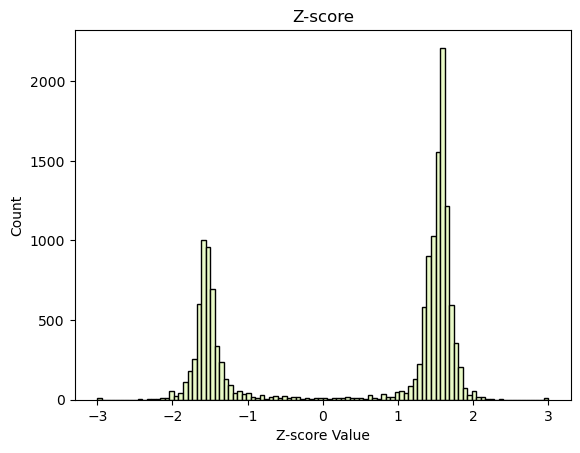

Outliner's count : 30.00


In [89]:
plt.hist(zList, bins=100, color='#e9fac8', edgecolor='black')
plt.title('Z-score')
plt.xlabel('Z-score Value')
plt.ylabel('Count')

plt.show()

print('Outliner\'s count : {:.2f}'.format(len(outlinerList)))

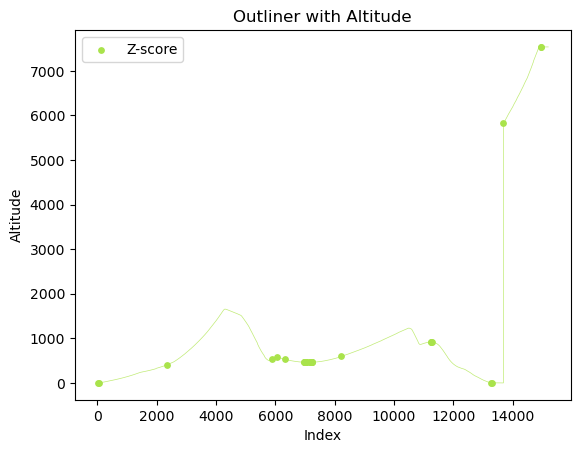

In [90]:
out = pd.DataFrame(outlinerList, columns= ['index', 'Altitude'])

plt.plot(df3.index, df3['velocity'], color='#c0eb75',lw=0.5, zorder=0)

plt.scatter(out['index'],out['Altitude'], color='#a9e34b', s=15, marker='o', label='Z-score', zorder=1)

plt.title('Outliner with Altitude')
plt.xlabel('Index')
plt.ylabel('Altitude')

plt.legend()

plt.show()

# 결론
### THRESHOLD를 2.9로 하면 이상치가 아닌 것도 잡힌다
### THRESHOLD를 3으로 하면 이상치가 잡히지만 정확도가 떨어진다. 또한, 3을 벗어나는 Zscore는 생성되지 않으므로 이상치 검출의 의미가 없다.
### WINDOW수와 Zscore 값은 비례한다
### 비정상적 양상의 그래프를 사용할 땐 오히려 정상 양상의 그래프보다 Zscore의 효율이 올라간다.